# Diabetes Health Indicators 
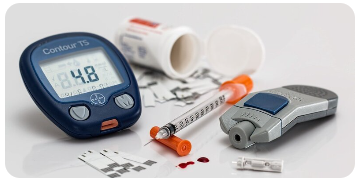

https://www.kaggle.com/datasets/alexteboul/diabetes-health-indicators-dataset

### Business case

Early diagnosis can lead to lifestyle changes and more effective treatment, making predictive models for diabetes risk important tools for public and public health officials.

### Context
The scale of this problem is also important to recognize. The Centers for Disease Control and Prevention has indicated that as of 2018, 34.2 million Americans have diabetes and 88 million have prediabetes. Furthermore, the CDC estimates that 1 in 5 diabetics, and roughly 8 in 10 prediabetics are unaware of their risk. While there are different types of diabetes, type II diabetes is the most common form and its prevalence varies by age, education, income, location, race, and other social determinants of health. Much of the burden of the disease falls on those of lower socioeconomic status as well. Diabetes also places a massive burden on the economy, with diagnosed diabetes costs of roughly 327 billion dollars and total costs with undiagnosed diabetes and prediabetes approaching $400 billion dollars annually.

### Content

The Behavioral Risk Factor Surveillance System (BRFSS) is a health-related telephone survey that is collected annually by the CDC. Each year, the survey collects responses from over 400,000 Americans on health-related risk behaviors, chronic health conditions, and the use of preventative services. It has been conducted every year since 1984. For this project, a csv of the dataset available on Kaggle for the year 2015 was used. This original dataset contains responses from 441,455 individuals and has 330 features. These features are either questions directly asked of participants, or calculated variables based on individual participant responses.

This dataset contains 3 files:

###### diabetes _ 012 _ health _ indicators _ BRFSS2015.csv 
Is a clean dataset of 253,680 survey responses to the CDC's BRFSS2015. The target variable Diabetes_012 has 3 classes. 0 is for no diabetes or only during pregnancy, 1 is for prediabetes, and 2 is for diabetes. There is class imbalance in this dataset. This dataset has 21 feature variables

###### diabetes _ binary _ 5050split _ health _ indicators _ BRFSS2015.csv 
is a clean dataset of 70,692 survey responses to the CDC's BRFSS2015. It has an equal 50-50 split of respondents with no diabetes and with either prediabetes or diabetes. The target variable Diabetes_binary has 2 classes. 0 is for no diabetes, and 1 is for prediabetes or diabetes. This dataset has 21 feature variables and is balanced.

###### diabetes _ binary _ health _ indicators _ BRFSS2015.csv
Is a clean dataset of 253,680 survey responses to the CDC's BRFSS2015. The target variable Diabetes_binary has 2 classes. 0 is for no diabetes, and 1 is for prediabetes or diabetes. This dataset has 21 feature variables and is not balanced.

### Steps strateies taken to classification of data 

###### Note: Keep in mind not all steps to classifiy data are included in below code it just shows the final code selected after several stratgies evaluted

1- load all three data CSV files into theree dataframes

2- Consolidated all the files

3- Clean data by removing duplicate

4 - Performed analysis on diabetes_012_health_indicators_BRFSS2015.csv" with three categories 0 = nondiabetec, 1 = Prediabetic & 2 = Diabetic of column "'Diabetes_012".  it came out that prediabteic data didn't improve predict/classification, therfore, the decision made to merging both categories  1 = Prediabetic & 2 = Diabetic (Analysis is NOT part of this code)

5- Convert target dicrectory data into two categories 0 = Non-Diabetic & 1 based on learing of above item #4 

6- Upsample minority samples

7- Standardized data for classes 0 and 1

8- Extract 5 feature importance 

9- Plot graphs for visualization

10- Compressed feature using PCA

11- Use RandomForest for Classification

12- Use Logistic regression for Classifocation

14- Use KNN for classification 

In [26]:
### Module 1: Setup environment

In [27]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

from sklearn.utils import resample
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import (
    classification_report, confusion_matrix, ConfusionMatrixDisplay,
    accuracy_score, precision_recall_curve, roc_curve, roc_auc_score, auc
)
from imblearn.over_sampling import SMOTE
from sklearn.datasets import make_classification


In [28]:
### Module 2:  Consolidate all the file data and display type of data type and columns

In [29]:

# Load datasets
file_1 = r"C:\Users\Farru\Downloads\Diabetic\data\diabetes_012_health_indicators_BRFSS2015.csv"
file_2 = r"C:\Users\Farru\Downloads\Diabetic\data\diabetes_binary_5050split_health_indicators_BRFSS2015.csv"
file_3 = r"C:\Users\Farru\Downloads\Diabetic\data\diabetes_binary_health_indicators_BRFSS2015.csv"

df1 = pd.read_csv(file_1)
df2 = pd.read_csv(file_2)
df3 = pd.read_csv(file_3)
print(df1.head())
print(df2.head())
print(df3.head())
df1. info()
df1. info()
df1. info()

   Diabetes_012  HighBP  HighChol  CholCheck   BMI  Smoker  Stroke  \
0           0.0     1.0       1.0        1.0  40.0     1.0     0.0   
1           0.0     0.0       0.0        0.0  25.0     1.0     0.0   
2           0.0     1.0       1.0        1.0  28.0     0.0     0.0   
3           0.0     1.0       0.0        1.0  27.0     0.0     0.0   
4           0.0     1.0       1.0        1.0  24.0     0.0     0.0   

   HeartDiseaseorAttack  PhysActivity  Fruits  ...  AnyHealthcare  \
0                   0.0           0.0     0.0  ...            1.0   
1                   0.0           1.0     0.0  ...            0.0   
2                   0.0           0.0     1.0  ...            1.0   
3                   0.0           1.0     1.0  ...            1.0   
4                   0.0           1.0     1.0  ...            1.0   

   NoDocbcCost  GenHlth  MentHlth  PhysHlth  DiffWalk  Sex   Age  Education  \
0          0.0      5.0      18.0      15.0       1.0  0.0   9.0        4.0   
1     

In [30]:
### Module 3:  Formatting data

In [31]:
# After analysis of file diabetes_012_health_indicators_BRFSS2015.csv" with three categories 0 = nondiabetec, 1 = Prediabetic 
# 2 = Diabetic of column "'Diabetes_012".  it came out that prediabteic data didn't improved predict/classification, therfore, 
# the decision made to merging both categories  1 = Prediabetic & 2 = Diabetic   

# Modify `Diabetes_012` in `df1` to replace 2 with 1.
df1['Diabetes_012'] = df1['Diabetes_012'].replace(2, 1)

# Rename `Diabetes_012` column in `df1` to `Diabetes_binary`
df1 = df1.rename(columns={'Diabetes_012': 'Diabetes_binary'})

# Concatenate all three datasets
consolidated_df = pd.concat([df1, df2, df3], ignore_index=True)

# Convert columns data from float64 to int32 to efficient usage of computer memory

for col in consolidated_df.select_dtypes(include=['float64']).columns:
    consolidated_df[col] = consolidated_df[col].astype(int)

# Ensure target column is integer
consolidated_df['Diabetes_binary'] = consolidated_df['Diabetes_binary'].astype(int)

# Drop columns Income & Education as those doesn't have feature 
consolidated_df.drop(['Income', 'Education'], axis=1, inplace=True, errors='ignore')

print(consolidated_df.head())
consolidated_df. info()

# Drop columns Income & Education
consolidated_df.drop(['Income', 'Education'], axis=1, inplace=True, errors='ignore')

# Dropping Duplicates
consolidated_df = consolidated_df.drop_duplicates()
print(consolidated_df.duplicated().sum())

# Sample a manageable subset for analysis
sampled_df = consolidated_df.sample(n=100000, random_state=42)

   Diabetes_binary  HighBP  HighChol  CholCheck  BMI  Smoker  Stroke  \
0                0       1         1          1   40       1       0   
1                0       0         0          0   25       1       0   
2                0       1         1          1   28       0       0   
3                0       1         0          1   27       0       0   
4                0       1         1          1   24       0       0   

   HeartDiseaseorAttack  PhysActivity  Fruits  Veggies  HvyAlcoholConsump  \
0                     0             0       0        1                  0   
1                     0             1       0        0                  0   
2                     0             0       1        0                  0   
3                     0             1       1        1                  0   
4                     0             1       1        1                  0   

   AnyHealthcare  NoDocbcCost  GenHlth  MentHlth  PhysHlth  DiffWalk  Sex  Age  
0              1       

In [32]:
### Module 4: Find feature importance 

In [33]:

# Prepare the data
X = consolidated_df.drop(columns=['Diabetes_binary'])
y = consolidated_df['Diabetes_binary']

# Standardize features (important for Logistic Regression)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Train Logistic Regression
model = LogisticRegression(random_state=42, max_iter=1000)
model.fit(X_scaled, y)

# Extract Feature Importance (absolute value of coefficients)
feature_importances = pd.DataFrame({
    'Feature': X.columns,
    'Importance': abs(model.coef_[0])
}).sort_values(by="Importance", ascending=False)


# Display top 5 features
print(feature_importances.head(5))


     Feature  Importance
13   GenHlth    0.488614
18       Age    0.393962
3        BMI    0.377038
0     HighBP    0.326403
1   HighChol    0.268465


In [34]:
### Module 5: Balance target features for minority as well as standardize feature

In [35]:
# Below code ensure minority & majority samples numbers are same. The minority class (df_minority) is upsampled using the 
# resample function from sklearn.utils.
# replace=True: Allows sampling with replacement, which is necessary for upsampling.
# n_samples=len(df_majority): Ensures the minority class is upsampled to have the same number of samples as the majority 
# class, creating balance.
# random_state=42: Ensures reproducibility of the random sampling.
# Separate majority and minority classes

df_majority = sampled_df[sampled_df.Diabetes_binary == 0]
df_minority = sampled_df[sampled_df.Diabetes_binary == 1]

# Upsample the minority class
df_minority_upsampled = resample(
    df_minority,
    replace=True,
    n_samples=len(df_majority),
    random_state=42
 )

# Combine the upsampled minority class with the majority class
balanced_df = pd.concat([df_majority, df_minority_upsampled])

# Standardize features. After applying the StandardScaler the scale is standerized for both class 0 and 1, the values of 
# two features are standardized:. The mean of each feature is now 0 and standard deviation of each feature is now 1.
# The standard deviation of each feature is now 1.
X = balanced_df.drop(columns=['Diabetes_binary'])
y = balanced_df['Diabetes_binary']
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [36]:
### Module 6: Data visualization

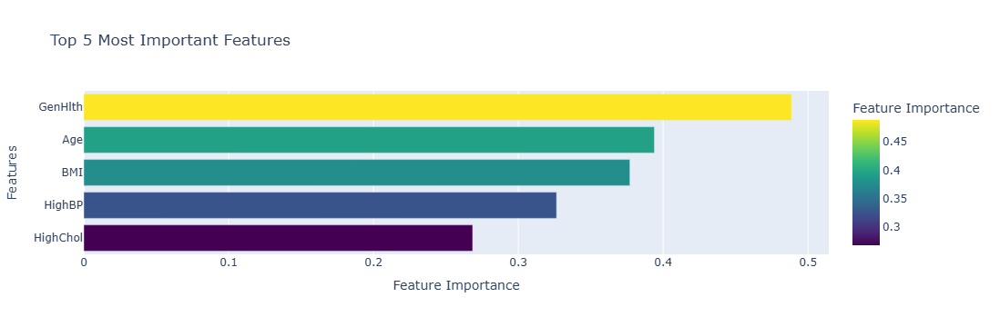

Percentage distribution of 'Diabetic_binary':
Diabetes_binary
0    80.909992
1    19.090008
Name: count, dtype: float64
Percentage distribution of 'Diabetic_binary' after feature balancing:
Diabetes_binary
0    50.0
1    50.0
Name: count, dtype: float64


In [37]:
# Visualize Top 5 Features
fig = px.bar(
    feature_importances.head(5),
    x="Importance",
    y="Feature",
    orientation="h",
    title="Top 5 Most Important Features",
    labels={"Importance": "Feature Importance", "Feature": "Features"},
    color="Importance",
    color_continuous_scale="viridis"
)
fig.update_layout(yaxis={"categoryorder": "total ascending"})
fig.show()

# Calculate the count of each class prior to class 0 & 1 balancing
diabetic_counts = consolidated_df['Diabetes_binary'].value_counts()

# Calculate the percentage for each class
diabetic_percentages = (diabetic_counts / diabetic_counts.sum()) * 100

# Display the percentages
print("Percentage distribution of 'Diabetic_binary':")
print(diabetic_percentages)

# Calculate the count of each class after class 0 & 1 balancing
diabetic_counts = balanced_df['Diabetes_binary'].value_counts()

# Calculate the percentage for each class
diabetic_percentages = (diabetic_counts / diabetic_counts.sum()) * 100

# Display the percentages
print("Percentage distribution of 'Diabetic_binary' after feature balancing:")
print(diabetic_percentages)

# Plot 1: Distribution of 'Diabetes_binary prior feature balancing'
fig1 = px.histogram(
    consolidated_df, 
    x='Diabetes_binary', 
    color='Diabetes_binary',
    title='Diabetes_binary prior class balancing', 
    labels={'Diabetes_binary': 'Diabetes_binary'},
    color_discrete_sequence=px.colors.qualitative.Set2
)
fig1.update_layout(xaxis_title='Diabetes_binary', yaxis_title='Count')
fig1.show()

# Plot 1: Distribution of 'Diabetes_binary after feature balancing'
fig1 = px.histogram(
    balanced_df, 
    x='Diabetes_binary', 
    color='Diabetes_binary',
    title='Diabetes_binary after class balancing', 
    labels={'Diabetes_binary': 'Diabetes_binary'},
    color_discrete_sequence=px.colors.qualitative.Set2
)
fig1.update_layout(xaxis_title='Diabetes_binary', yaxis_title='Count')
fig1.show()

# Plot 2: Distribution of 'BMI'
fig2 = px.histogram(
    balanced_df, 
    x='BMI', 
    color='BMI',
    title='Distribution of BMI', 
    labels={'BMI': 'BMI'},
    color_discrete_sequence=px.colors.qualitative.Set1
)
fig2.update_layout(xaxis_title='BMI', yaxis_title='Count')
fig2.show()

# Plot 3: Distribution of 'GenHlth'
fig3 = px.histogram(
    balanced_df, 
    x='GenHlth', 
    color='GenHlth',
    title='Distribution of GenHlth', 
    labels={'GenHlth': 'GenHlth'},
    color_discrete_sequence=px.colors.qualitative.Vivid
)
fig3.update_layout(xaxis_title='GenHlth', yaxis_title='Count')
fig3.show()

# Plot 4: Distribution of 'Age'
fig4 = px.histogram(
    balanced_df, 
    x='Age', 
    color='Age',
    title='Distribution of Age', 
    labels={'Age': 'Age'},
    color_discrete_sequence=px.colors.qualitative.Plotly
)
fig4.update_layout(xaxis_title='Age', yaxis_title='Count')
fig4.show()

# Plot 5: Distribution of 'HighBP'
fig5 = px.histogram(
    balanced_df, 
    x='HighBP', 
    color='HighBP',
    title='Distribution of HighBP', 
    labels={'HighBP': 'HighBP'},
    color_discrete_sequence=px.colors.qualitative.Plotly
)
fig5.update_layout(xaxis_title='HighBP', yaxis_title='Count')
fig5.show()

# Plot 6: Distribution of 'HighChol'
fig5 = px.histogram(
    balanced_df, 
    x='HighChol', 
    color='HighChol',
    title='Distribution of HighChol', 
    labels={'HighChol': 'HighChol'},
    color_discrete_sequence=px.colors.qualitative.Plotly
)
fig5.update_layout(xaxis_title='HighChol', yaxis_title='Count')
fig5.show()


#### Percentage distribution of 'Diabetic_binary' prior feature balancing:
Diabetes_binary
0.0    80.854837
1.0    19.145163

#### Percentage distribution of 'Diabetic_binary'after feature balancing:
Diabetes_binary
0    50.0
1    50.0

#### Percentage distribution of 'Diabetic_binary' prior feature balancing:
Diabetes_binary
0.0    50
1.0    19.145163

#### BMI (Body Mass Index)

Below 18.5	Underweight
18.5 – 24.9	Normal weight
25.0 – 29.9	Overweight
30.0 and above	Obese

#### GenHlth (General Health)

1: Excellent
2: Very Good
3: Good
4: Fair
5: Poor

#### HighBP (High Blood Pressure) & HighChol (Hiogh Cholestrol)

Majority of class 1 (diabetic cases) has high blood pressure & High choletrol


### Module 6 - Using RandomForest for classification

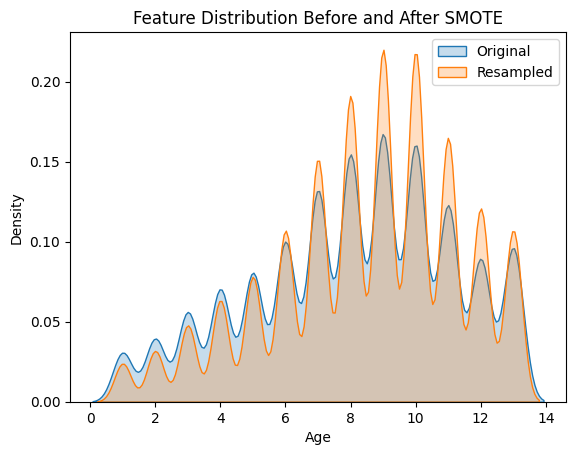


Evaluation at Threshold = 0.4
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.60      0.71     16190
           1       0.70      0.91      0.79     16189

    accuracy                           0.76     32379
   macro avg       0.79      0.76      0.75     32379
weighted avg       0.79      0.76      0.75     32379



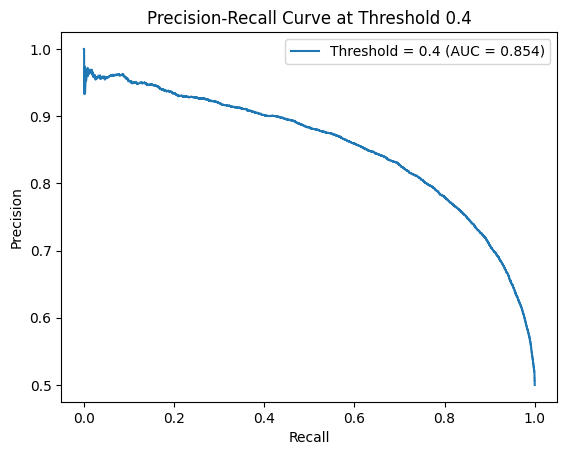

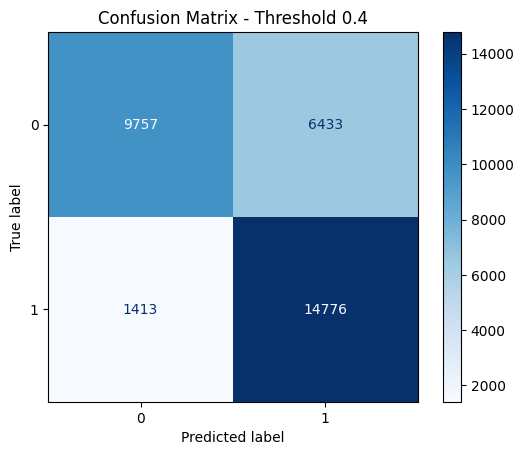


Evaluation at Threshold = 0.555
Classification Report:
              precision    recall  f1-score   support

           0       0.79      0.78      0.78     16190
           1       0.78      0.80      0.79     16189

    accuracy                           0.79     32379
   macro avg       0.79      0.79      0.79     32379
weighted avg       0.79      0.79      0.79     32379



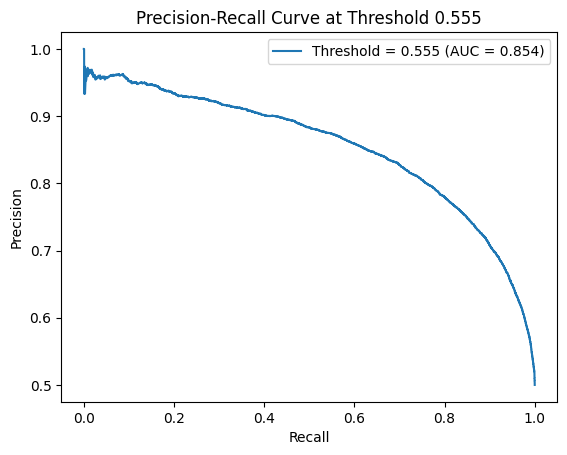

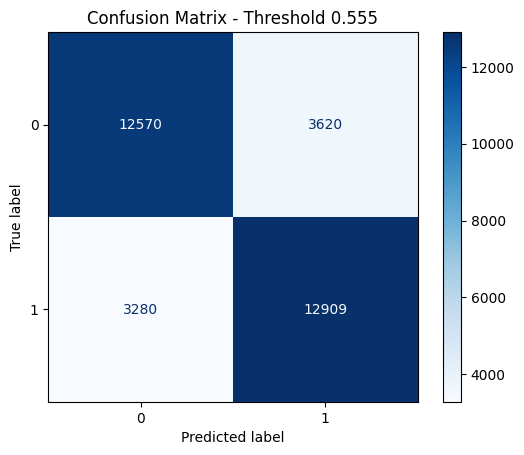


Evaluation at Threshold = 0.6
Classification Report:
              precision    recall  f1-score   support

           0       0.76      0.82      0.79     16190
           1       0.81      0.75      0.78     16189

    accuracy                           0.78     32379
   macro avg       0.79      0.78      0.78     32379
weighted avg       0.79      0.78      0.78     32379



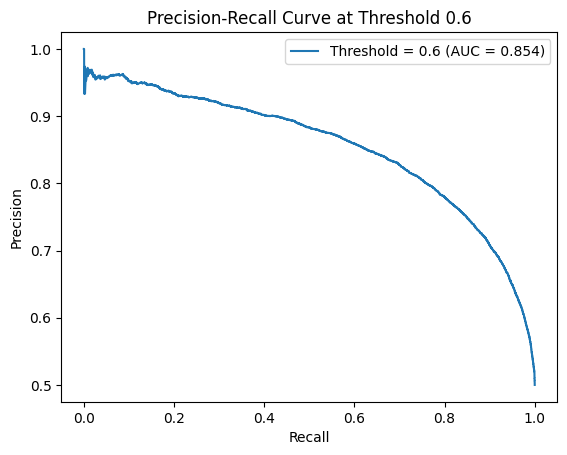

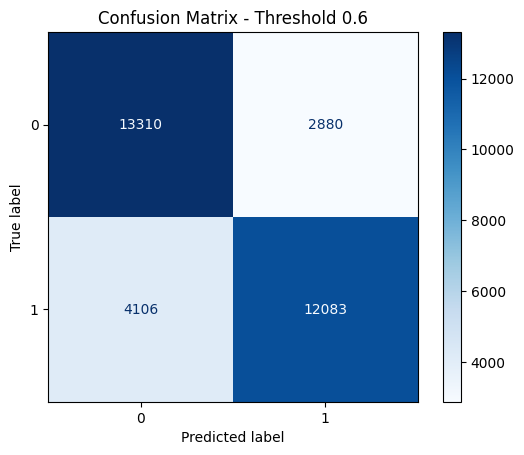


Evaluation at Threshold = 0.7
Classification Report:
              precision    recall  f1-score   support

           0       0.69      0.90      0.78     16190
           1       0.86      0.59      0.70     16189

    accuracy                           0.75     32379
   macro avg       0.78      0.75      0.74     32379
weighted avg       0.78      0.75      0.74     32379



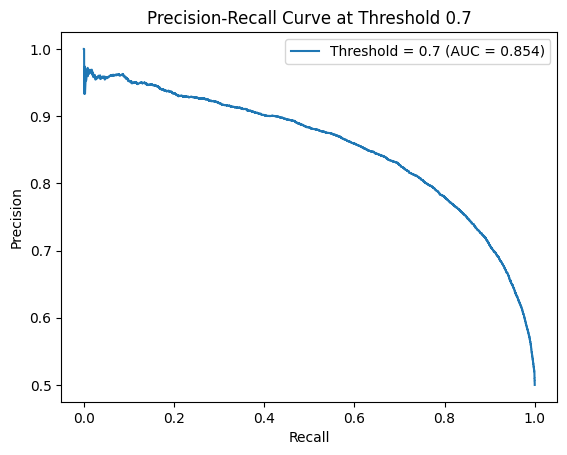

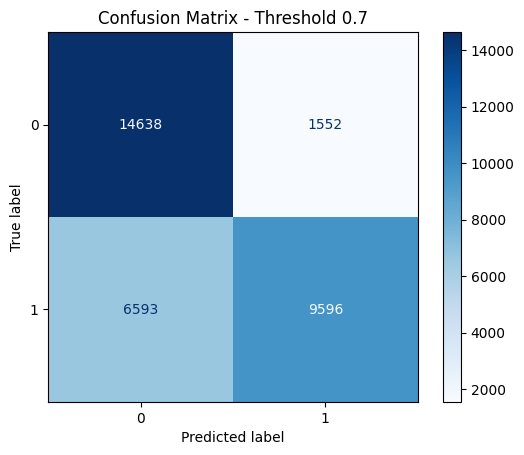

Best Parameters for Random Forest: {'max_depth': 20, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 200}


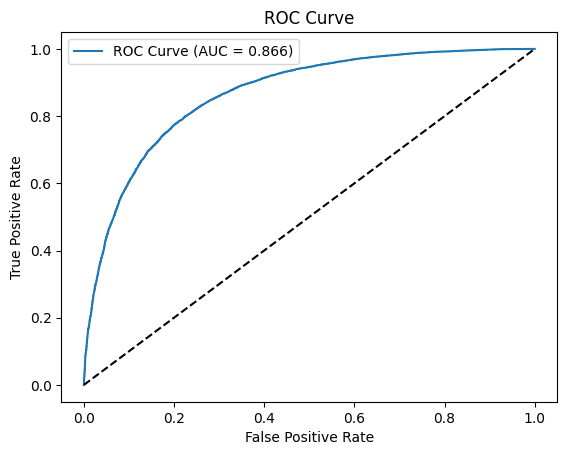

Best G-Mean: 0.787 at Threshold: 0.555


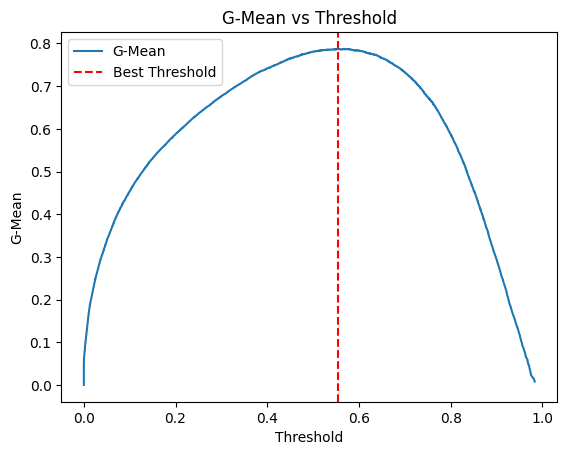

In [38]:

# Balance dataset using SMOTE. Although this is redendant step but I like to use SMOTE as it great visulization. 
X = sampled_df.drop(columns=['Diabetes_binary'])
y = sampled_df['Diabetes_binary']
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X, y)

# Visualize feature distribution before and after SMOTE
feature = 'Age'  # Example feature to visualize
sns.kdeplot(data=X[feature], label='Original', fill=True)
sns.kdeplot(data=X_resampled[feature], label='Resampled', fill=True)
plt.title('Feature Distribution Before and After SMOTE')
plt.legend()
plt.show()

# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(
    X_resampled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled
)

# Standardize features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply PCA
pca = PCA(n_components=10)  # Use first 10 components
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)

# 3D PCA Visualization
pca_df = pd.DataFrame(X_train_pca[:, :3], columns=['PC1', 'PC2', 'PC3'])
pca_df['Target'] = y_train.values

fig = px.scatter_3d(
    pca_df, x='PC1', y='PC2', z='PC3', color='Target',
    title='3D PCA Visualization of Features (First 3 Components)',
    labels={'PC1': 'Principal Component 1', 'PC2': 'Principal Component 2', 'PC3': 'Principal Component 3'}
)
fig.update_layout(width=1000, height=800)
fig.show()

# Define and tune Random Forest model
rf_model = RandomForestClassifier(random_state=42, class_weight='balanced')
params = {
    'n_estimators': [100, 200],
    'max_depth': [10, 20],
    'min_samples_split': [5, 10],
    'min_samples_leaf': [2, 4]
}
grid = GridSearchCV(rf_model, params, cv=3, scoring='precision', n_jobs=-1)
grid.fit(X_train_pca, y_train)

# Best model
best_rf = grid.best_estimator_
y_pred_proba = best_rf.predict_proba(X_test_pca)[:, 1]

# Evaluate at thresholds
thresholds = [0.4,0.555,0.6,0.7]
for threshold in thresholds:
    y_pred = (y_pred_proba >= threshold).astype(int)
    print(f"\nEvaluation at Threshold = {threshold}")
    print("Classification Report:")
    print(classification_report(y_test, y_pred))
    precision, recall, _ = precision_recall_curve(y_test, y_pred_proba)
    pr_auc = auc(recall, precision)
    plt.figure()
    plt.plot(recall, precision, label=f'Threshold = {threshold} (AUC = {pr_auc:.3f})')
    plt.xlabel("Recall")
    plt.ylabel("Precision")
    plt.title(f"Precision-Recall Curve at Threshold {threshold}")
    plt.legend()
    plt.show()
    cm = confusion_matrix(y_test, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
    disp.plot(cmap='Blues')
    plt.title(f"Confusion Matrix - Threshold {threshold}")
    plt.show()

print("Best Parameters for Random Forest:", grid.best_params_)

# Feature Importance
importances = best_rf.feature_importances_
feature_names = [f'PC{i}' for i in range(1, 11)]
importance_df = pd.DataFrame({'Features': feature_names, 'Importance': importances})
importance_df = importance_df.sort_values(by='Importance', ascending=False)

fig_importance = px.bar(
    importance_df, x='Importance', y='Features',
    title='Top Features from Random Forest',
    orientation='h',
    color='Importance',
    color_continuous_scale='viridis'
)
fig_importance.show()

# ROC Curve and G-Mean
fpr, tpr, thresholds_roc = roc_curve(y_test, y_pred_proba)
roc_auc = roc_auc_score(y_test, y_pred_proba)
plt.figure()
plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.3f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend()
plt.show()

gmeans = np.sqrt(tpr * (1 - fpr))
best_idx = np.argmax(gmeans)
print(f"Best G-Mean: {gmeans[best_idx]:.3f} at Threshold: {thresholds_roc[best_idx]:.3f}")
plt.figure()
plt.plot(thresholds_roc, gmeans, label='G-Mean')
plt.axvline(x=thresholds_roc[best_idx], color='red', linestyle='--', label='Best Threshold')
plt.xlabel('Threshold')
plt.ylabel('G-Mean')
plt.title('G-Mean vs Threshold')
plt.legend()
plt.show()


In [40]:
### Module 7 - Using Logistic Regression for classification


Evaluation at Threshold = 0.4
Classification Report:
              precision    recall  f1-score   support

           0       0.76      0.53      0.62     16190
           1       0.64      0.83      0.72     16189

    accuracy                           0.68     32379
   macro avg       0.70      0.68      0.67     32379
weighted avg       0.70      0.68      0.67     32379



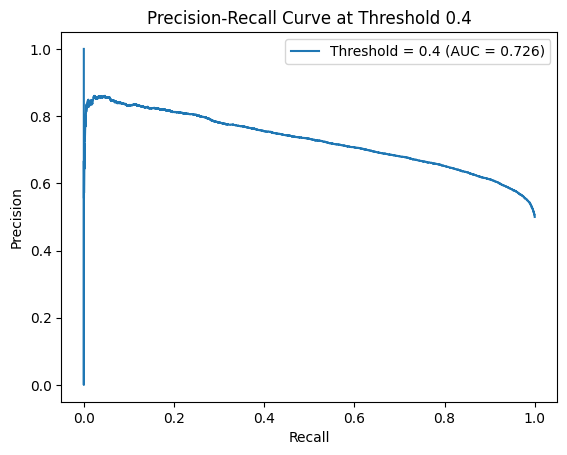

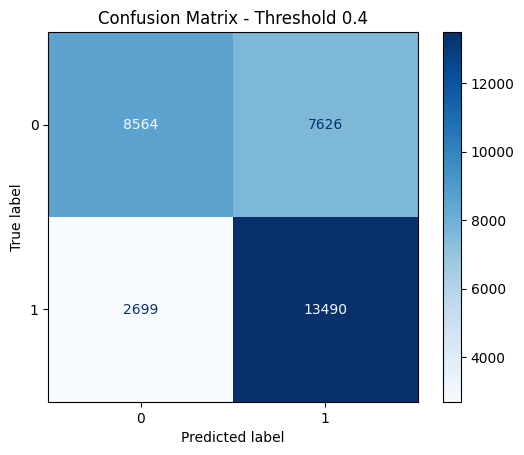


Evaluation at Threshold = 0.489
Classification Report:
              precision    recall  f1-score   support

           0       0.70      0.66      0.68     16190
           1       0.68      0.72      0.70     16189

    accuracy                           0.69     32379
   macro avg       0.69      0.69      0.69     32379
weighted avg       0.69      0.69      0.69     32379



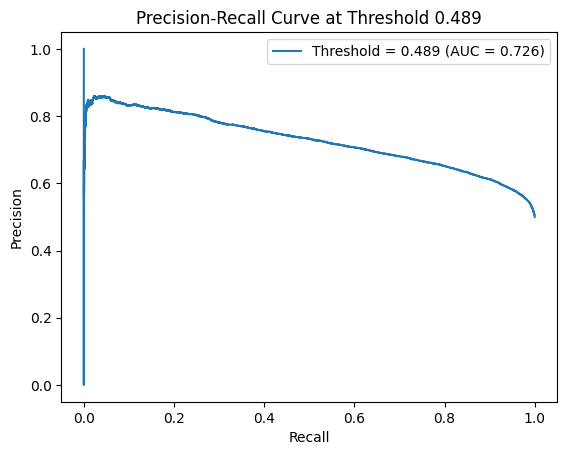

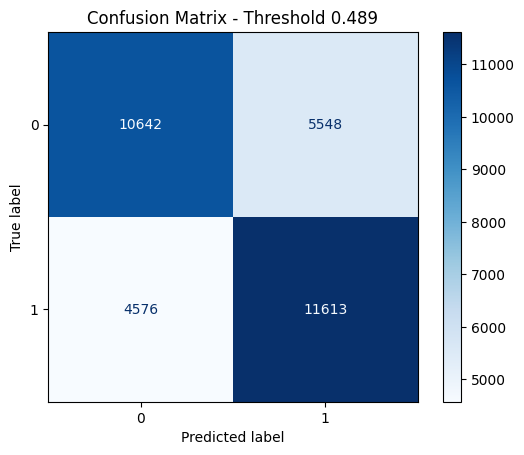


Evaluation at Threshold = 0.5
Classification Report:
              precision    recall  f1-score   support

           0       0.69      0.67      0.68     16190
           1       0.68      0.70      0.69     16189

    accuracy                           0.69     32379
   macro avg       0.69      0.69      0.69     32379
weighted avg       0.69      0.69      0.69     32379



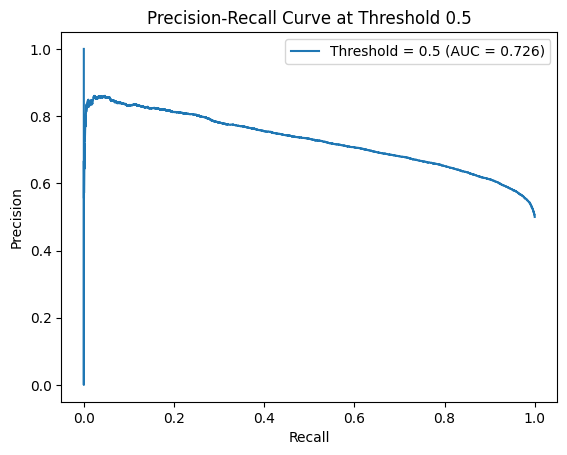

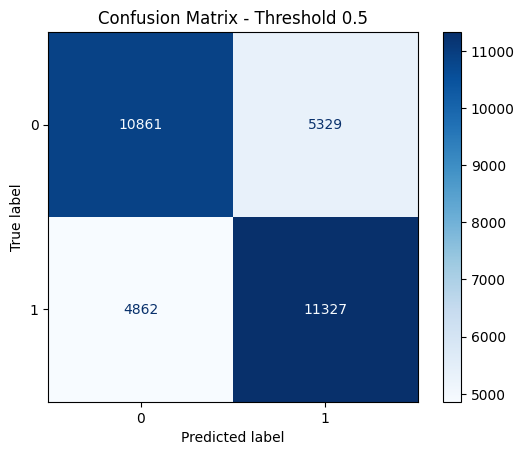


Evaluation at Threshold = 0.6
Classification Report:
              precision    recall  f1-score   support

           0       0.63      0.80      0.70     16190
           1       0.72      0.53      0.61     16189

    accuracy                           0.66     32379
   macro avg       0.68      0.66      0.66     32379
weighted avg       0.68      0.66      0.66     32379



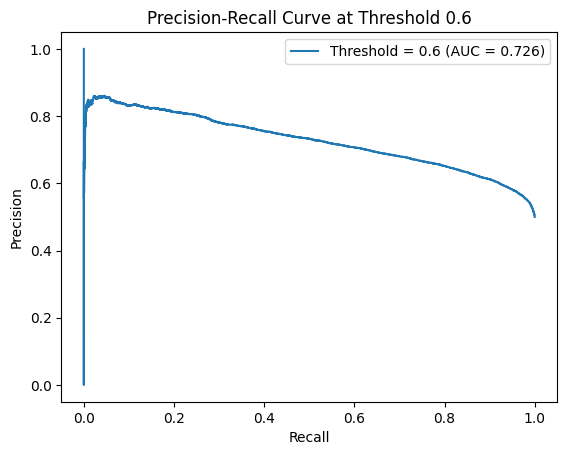

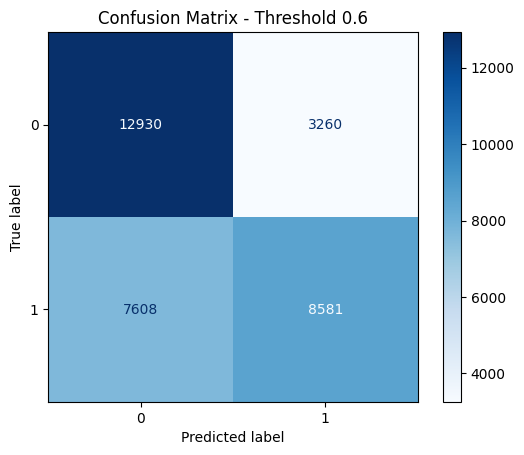

Best Parameters for Logistic Regression: {'C': 1, 'penalty': 'l2'}


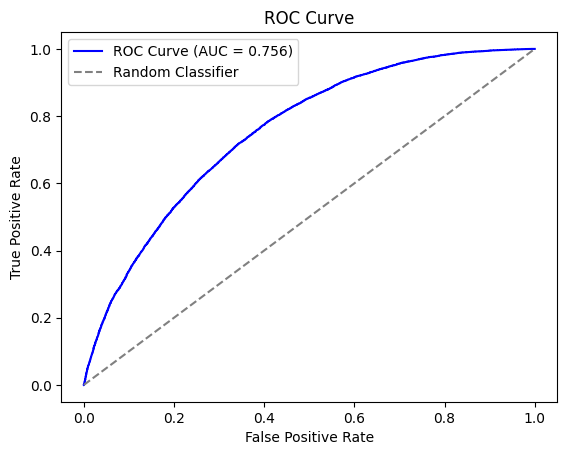

Best G-Mean: 0.687 at Threshold: 0.489


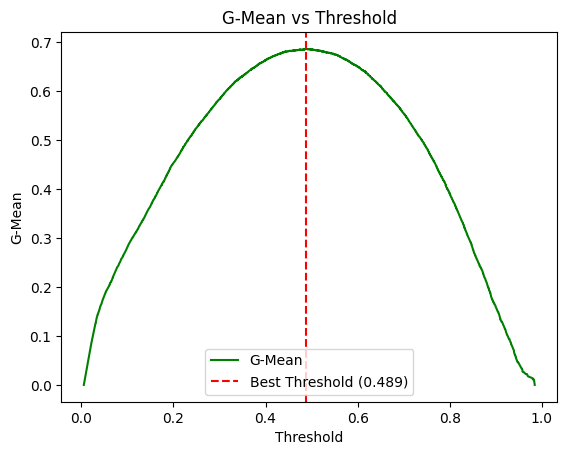

In [41]:

# Assuming X_train, X_test, y_train, y_test are already defined and preprocessed

# Apply PCA to the training data
pca = PCA(n_components=10)  # Adjust n_components as needed
X_pca_train = pca.fit_transform(X_train)
X_pca_test = pca.transform(X_test)

# Define and tune Logistic Regression model
logreg_model = LogisticRegression(solver='liblinear')
params = {
    'penalty': ['l1', 'l2'],
    'C': [0.01, 0.1, 1, 10, 100]
}
grid = GridSearchCV(logreg_model, params, cv=3, scoring='precision', n_jobs=-1)
grid.fit(X_train_pca, y_train)

# Best model
best_logreg = grid.best_estimator_
y_pred_proba = best_logreg.predict_proba(X_test_pca)[:, 1]

# Evaluate at thresholds
thresholds = [0.4,0.489,0.5,0.6]
for threshold in thresholds:
    print(f"\nEvaluation at Threshold = {threshold}")
    y_pred = (y_pred_proba >= threshold).astype(int)
    
    # Classification Report
    print("Classification Report:")
    print(classification_report(y_test, y_pred))
    
    # Precision-Recall Curve
    precision, recall, _ = precision_recall_curve(y_test, y_pred_proba)
    pr_auc = auc(recall, precision)
    plt.figure()
    plt.plot(recall, precision, label=f'Threshold = {threshold} (AUC = {pr_auc:.3f})')
    plt.xlabel("Recall")
    plt.ylabel("Precision")
    plt.title(f"Precision-Recall Curve at Threshold {threshold}")
    plt.legend()
    plt.show()
    
    # Confusion Matrix
    cm = confusion_matrix(y_test, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
    disp.plot(cmap='Blues')
    plt.title(f"Confusion Matrix - Threshold {threshold}")
    plt.show()

print("Best Parameters for Logistic Regression:", grid.best_params_)

# ROC Curve and AUC
fpr, tpr, thresholds_roc = roc_curve(y_test, y_pred_proba)
roc_auc = roc_auc_score(y_test, y_pred_proba)

# Plot ROC Curve
plt.figure()
plt.plot(fpr, tpr, color='blue', label=f'ROC Curve (AUC = {roc_auc:.3f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', label='Random Classifier')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend()
plt.show()

# Calculate G-Mean at each threshold
gmeans = np.sqrt(tpr * (1 - fpr))
best_threshold_idx = np.argmax(gmeans)
best_gmean = gmeans[best_threshold_idx]
best_threshold = thresholds_roc[best_threshold_idx]

print(f"Best G-Mean: {best_gmean:.3f} at Threshold: {best_threshold:.3f}")

# Plot G-Mean vs. Threshold
plt.figure()
plt.plot(thresholds_roc, gmeans, color='green', label='G-Mean')
plt.axvline(x=best_threshold, color='red', linestyle='--', label=f'Best Threshold ({best_threshold:.3f})')
plt.xlabel('Threshold')
plt.ylabel('G-Mean')
plt.title('G-Mean vs Threshold')
plt.legend()
plt.show()



In [43]:
### Module 8 - Using KNN for classification


Evaluation at Threshold = 0.4
Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.65      0.73     16190
           1       0.71      0.88      0.79     16189

    accuracy                           0.76     32379
   macro avg       0.78      0.76      0.76     32379
weighted avg       0.78      0.76      0.76     32379



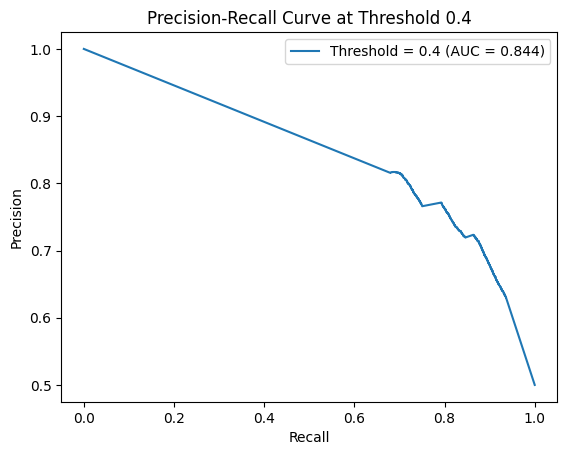

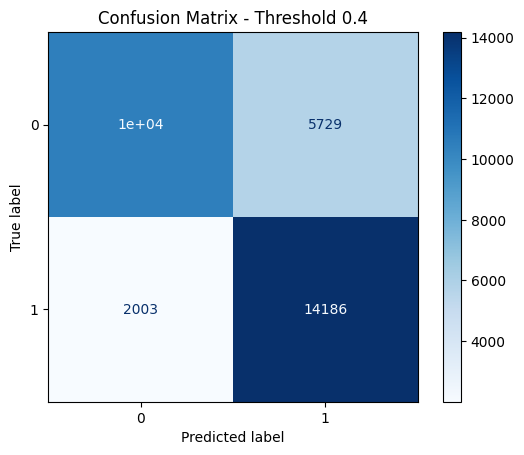


Evaluation at Threshold = 0.5
Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.67      0.74     16190
           1       0.72      0.86      0.79     16189

    accuracy                           0.77     32379
   macro avg       0.78      0.77      0.76     32379
weighted avg       0.78      0.77      0.76     32379



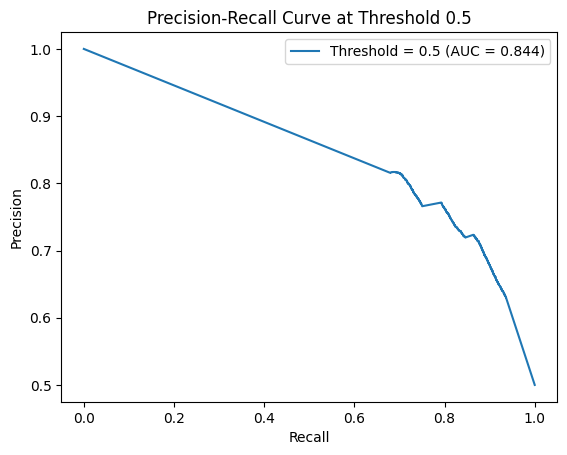

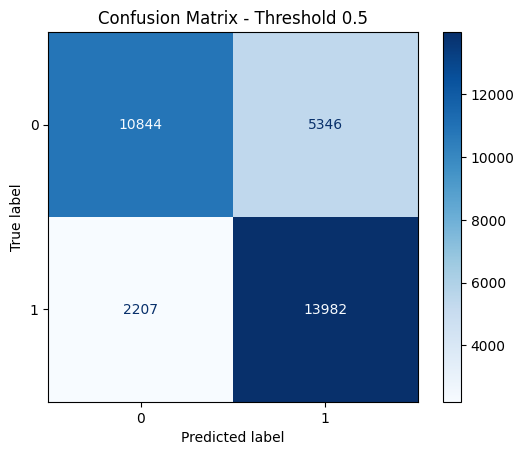


Evaluation at Threshold = 0.667
Classification Report:
              precision    recall  f1-score   support

           0       0.76      0.78      0.76     16190
           1       0.77      0.75      0.76     16189

    accuracy                           0.76     32379
   macro avg       0.76      0.76      0.76     32379
weighted avg       0.76      0.76      0.76     32379



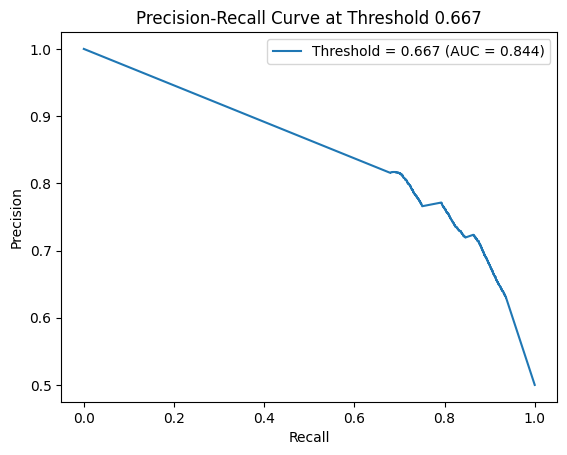

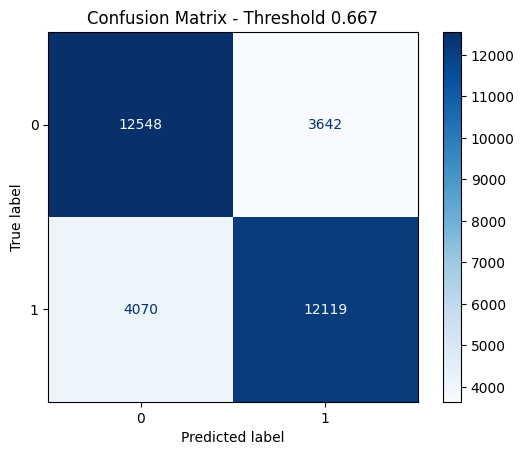


Evaluation at Threshold = 0.7
Classification Report:
              precision    recall  f1-score   support

           0       0.75      0.81      0.78     16190
           1       0.79      0.73      0.76     16189

    accuracy                           0.77     32379
   macro avg       0.77      0.77      0.77     32379
weighted avg       0.77      0.77      0.77     32379



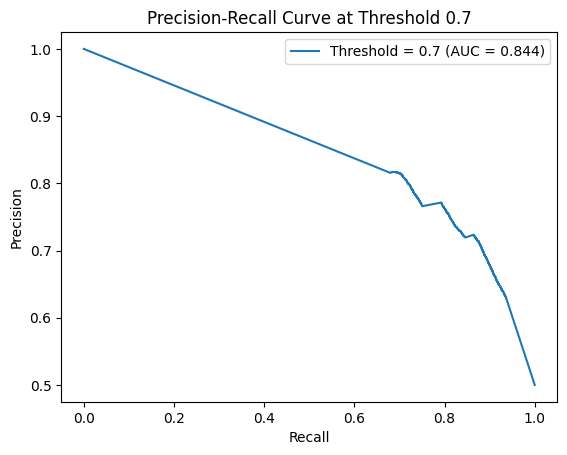

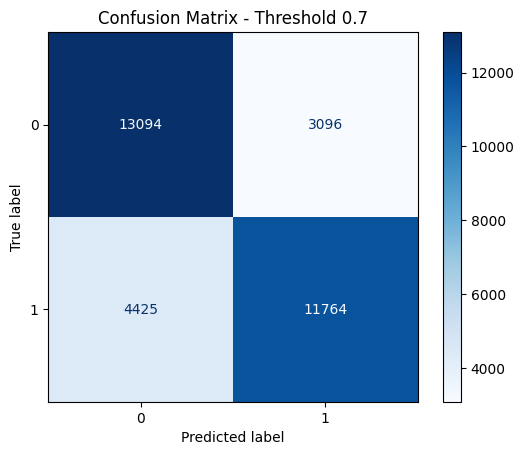

Best Parameters for K-Nearest Neighbors: {'metric': 'manhattan', 'n_neighbors': 3, 'weights': 'distance'}


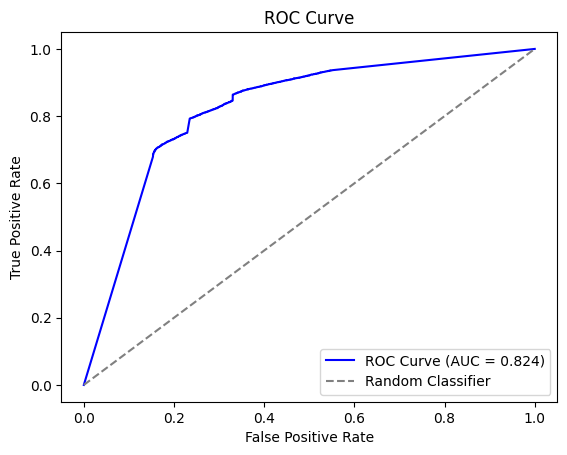

Best G-Mean: 0.779 at Threshold: 0.667


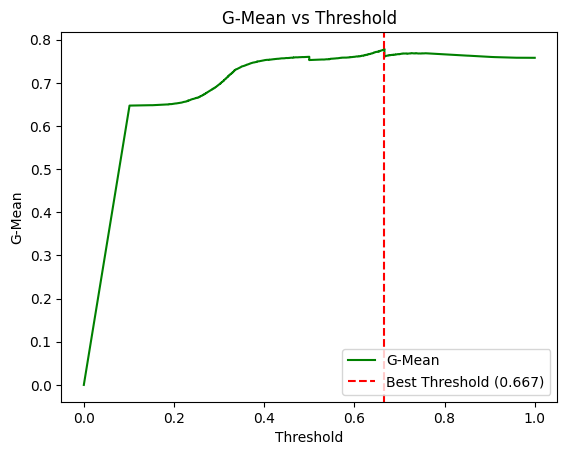

In [44]:

# Apply PCA for dimensionality reduction
pca = PCA(n_components=10)  # Use first 10 components
X_pca = pca.fit_transform(X_train_scaled)
X_pca_test = pca.transform(X_test_scaled)

# Define and tune K-Nearest Neighbors model
knn_model = KNeighborsClassifier()
params = {
    'n_neighbors': [3, 5, 7, 9, 11],
    'weights': ['uniform', 'distance'],
    'metric': ['euclidean', 'manhattan', 'minkowski']
}
grid = GridSearchCV(knn_model, params, cv=3, scoring='precision', n_jobs=-1)
grid.fit(X_pca, y_train)

# Best model
best_knn = grid.best_estimator_
y_pred_proba = best_knn.predict_proba(X_pca_test)[:, 1]

# Evaluate at thresholds
thresholds = [0.4,0.5, 0.667,0.7]
for threshold in thresholds:
    print(f"\nEvaluation at Threshold = {threshold}")
    y_pred = (y_pred_proba >= threshold).astype(int)
    
    # Classification Report
    print("Classification Report:")
    print(classification_report(y_test, y_pred))
    
    # Precision-Recall Curve
    precision, recall, _ = precision_recall_curve(y_test, y_pred_proba)
    pr_auc = auc(recall, precision)
    plt.figure()
    plt.plot(recall, precision, label=f'Threshold = {threshold} (AUC = {pr_auc:.3f})')
    plt.xlabel("Recall")
    plt.ylabel("Precision")
    plt.title(f"Precision-Recall Curve at Threshold {threshold}")
    plt.legend()
    plt.show()
    
    # Confusion Matrix
    cm = confusion_matrix(y_test, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
    disp.plot(cmap='Blues')
    plt.title(f"Confusion Matrix - Threshold {threshold}")
    plt.show()

print("Best Parameters for K-Nearest Neighbors:", grid.best_params_)

# ROC Curve and AUC
fpr, tpr, thresholds_roc = roc_curve(y_test, y_pred_proba)
roc_auc = roc_auc_score(y_test, y_pred_proba)

# Plot ROC Curve
plt.figure()
plt.plot(fpr, tpr, color='blue', label=f'ROC Curve (AUC = {roc_auc:.3f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', label='Random Classifier')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend()
plt.show()

# Calculate G-Mean at each threshold
gmeans = np.sqrt(tpr * (1 - fpr))
best_threshold_idx = np.argmax(gmeans)
best_gmean = gmeans[best_threshold_idx]
best_threshold = thresholds_roc[best_threshold_idx]

print(f"Best G-Mean: {best_gmean:.3f} at Threshold: {best_threshold:.3f}")

# Plot G-Mean vs. Threshold
plt.figure()
plt.plot(thresholds_roc, gmeans, color='green', label='G-Mean')
plt.axvline(x=best_threshold, color='red', linestyle='--', label=f'Best Threshold ({best_threshold:.3f})')
plt.xlabel('Threshold')
plt.ylabel('G-Mean')
plt.title('G-Mean vs Threshold')
plt.legend()
plt.show()

